# II. Инструменты геоанализа (1)


В этом занятии мы познакомимся с базовыми методами пространственного анализа данных, используя возможности библиотек GeoPandas и Shapely. Мы научимся строить буферные зоны, выполнять пространственные объединения (spatial join), и пространственную фильтрацию, а также применять эти инструменты на практике: агрегировать точечные данные по ячейкам регулярной сетки.

Эти навыки подготовят нас к анализу исторической вспышки холеры в Лондоне (1854) – [второму проекту](../projects/project2.ipynb) на нашем курсе.


**Импортируем библиотеки**


Первым делом подключим необходимые библиотеки


In [1]:
import geopandas as gpd
import osmnx as ox

from shapely.geometry import Point, Polygon, box
import matplotlib.pyplot as plt


<p style="color:#26528C; font-style:italic"><strong>GeoPandas</strong> – надстройка над pandas, расширяющая возможности DataFrame для работы с геометрией. Хранит объекты геометрии (точки, линии, полигоны) в специальном столбце `geometry` и предоставляет методы для пространственных операций (буферизация, объединение, объединение по пространственному признаку).</p> <p style="color:#26528C; font-style:italic"><strong>osmnx</strong> – библиотека для загрузки и анализа данных OpenStreetMap. Позволяет легко получать графы улиц, точки интереса и другие геоданные напрямую из OSM, а также выполнять маршрутизацию, визуализацию и базовый пространственный анализ городских сетей.</p><p style="color:#26528C; font-style:italic"><strong>Shapely</strong> – библиотека для создания и операций над геометрическими примитивами (точки, линии, полигоны). Предоставляет методы для объединения, пересечения, измерения расстояний и вычисления буферных зон.</p> <p style="color:#26528C; font-style:italic"><strong>matplotlib.pyplot</strong> – модуль визуализации, вдохновлённый MATLAB. Позволяет строить 2D-графики (линии, гистограммы, scatter-плоты), настраивать оформление, добавлять подписи, легенды и работать с осями.</p> <p style="color:#26528C; font-style:italic"><strong>contextily</strong> – утилита для подложек карт (tile basemaps) в matplotlib. Позволяет легко добавить тайловые слои (OpenStreetMap, Stamen и др.) под ваши геоплоты, автоматически приводя проекции в соответствие.</p>


## 1. Базовые инструменты пространственного анализа


Прежде чем переходить к основным инструментам, рассмотрим простые операции с геоданными: повторим как мы работаем с разными системами координат, рассмотрим измерение расстояний, буферизацию и пространственные отношения между объектами


### 1.1 Создание точек и перепроецирование (повторение)


Для дальнешей работы создадим две точки на основе координат в Санкт-Петербурге


In [2]:
# Задаем координаты двух точек (долгота, широта) 
lon1, lat1 = 30.3359, 59.9316  # Основное здание Александринского театра (историческая сцена)
lon2, lat2 = 30.3322, 59.9385   # Государственный Русский музей (Михайловский дворец)

# Создаем GeoSeries из этих точек с указанием CRS WGS84 (EPSG:4326 - географическая система координат)
points = gpd.GeoSeries([Point(lon1, lat1), Point(lon2, lat2)], crs="EPSG:4326")
points


0    POINT (30.3359 59.9316)
1    POINT (30.3322 59.9385)
dtype: geometry

Посмотрим на точки на карте


In [3]:
points.explore(tiles='CartoDB positron')

Мы создали две точки в географической системе координат WGS84 – широта и долгота в градусах.

Однако, как мы помним, для многих аналитических задач (например, расчета расстояний, площадей) предпочтительно использовать систему координат в метрических единицах.


Проверим текущую систему координат наших данных


In [4]:
current_crs = points.crs
print("Текущая система координат:", current_crs)


Текущая система координат: EPSG:4326


Оценим подходящую UTM-зону для наших точек и перепроецируем в нее


In [5]:
utm_crs = points.estimate_utm_crs()       # автоматически определяем UTM-зону
points_utm = points.to_crs(utm_crs)       # преобразуем GeoSeries в эту проекцию
print("Новая система координат:", points_utm.crs)

Новая система координат: EPSG:32636


Теперь обе точки заданы в спроецированной системе координат (UTM Zone, в метрах). Вычислим расстояние между ними.

Сначала попробуем вычислить расстояние напрямую в географической CRS (в градусах), а затем в метрической CRS:


In [6]:
# Расстояние между точками в градусах (как есть, в исходной CRS)
dist_deg = points[0].distance(points[1])
# Расстояние между точками в метрах (после проекции в UTM)
dist_m = points_utm[0].distance(points_utm[1])
print(f"Расстояние в градусах: {dist_deg:.6f}°")
print(f"Расстояние в метрах: ~{dist_m:.0f} м")

Расстояние в градусах: 0.007829°
Расстояние в метрах: ~796 м


В дальнейшем, **всегда перед измерением расстояний или площадей, убедимся, что данные заданы в метрической системе координат**.


### 1.2 Буферные зоны (Buffer)


**Буферная зона** – это область вокруг геометрического объекта на заданном расстоянии. Чаще всего буфер строят вокруг точек, линий или полигонов, чтобы выделить зону влияния или ближайшего окружения.

**При работе с буферами важно помнить про систему координат**: в географической системе координат (широта/долгота) радиус буфера указывается в градусах. Поэтому для измерения реальных расстояний буфер можно строить после в метрических системах координат (например, UTM).


In [7]:
buffer_500 = points_utm.buffer(500)

buffer_500.explore(tiles='CartoDB positron')

Построение буферных зон — относительно простая операция, но она регулярно применяется в пространственном анализе. При ее выполнении особенно важно внимательно отслеживать единицы измерения в используемой системе координат.


### 1.3 Пространственное объединение (Spatial Join)


**Пространственное объединение (spatial join)** — операция, при которой к каждому объекту одного слоя присоединяются атрибуты объекта другого слоя, с которым он связан пространственно. Это может быть принадлежность к району, попадание в буфер и т.д.

Однако само по себе пространственное объединение — это не только механическое добавление атрибутов на основе пересечений геометрий. Чтобы этот процесс был действительно точным и осмысленным, важно понимать, каким именно образом соотносятся объекты в пространстве. Пересекаются ли они? Один внутри другого? Или, быть может, лишь касаются границ?
Для того чтобы корректно интерпретировать такие случаи, используются пространственные предикаты — ключевой инструмент в пространственном анализе, позволяющий задать и проверить топологические отношения между геометриями.

**Пространственные предикаты** – это функции, позволяющие определить топологическое отношение между двумя геометрическими объектами (точками, линиями, полигонами и т.д.). Предикаты позволяют отвечать на вопросы вроде: «Пересекаются ли эти объекты?», «Находится ли один объект внутри другого?», «Касаются ли они границ друг друга?» и т.п. Знание пространственных отношений помогает выполнять пространственные запросы и объединения данных (spatial join), фильтрацию на основе взаимного расположения и др.

Ниже приведена таблица основных бинарных предикатов (отношений) с кратким описанием:

| **Предикат**                     | **Описание** (условие истинности)                                                                                                                                                                                                                                                                 |
| -------------------------------- | ------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| **intersects** (_пересекается_)  | **Имеют общую точку** – Геометрии пересекаются, если они имеют хотя бы одну общую точку в пространстве (любое наложение границ или внутренних областей). Эквивалентно логическому отрицанию disjoint (см. ниже).                                                                                  |
| **disjoint** (_не пересекается_) | **Не имеют общих точек** – Геометрии не пересекаются, если у них **нет ни одной** общей точки. То есть полностью разделены в пространстве.                                                                                                                                                        |
| **within** (_внутри_)            | **A внутри B** – Геометрия A находится целиком внутри геометрии B, не выходя за ее границы. Все точки A (и граница, и внутренняя часть) лежат во внутренней области B. (Эквивалентно B.contains(A)).                                                                                              |
| **contains** (_содержит_)        | **A содержит B** – Геометрия A полностью содержит геометрию B. То есть ни одна часть B не лежит вне A, при этом B не просто граничит с A, а имеет хотя бы одну точку строго внутри A. (Эквивалентно B.within(A)).                                                                                 |
| **touches** (_касается_)         | **Касание границ** – Геометрии имеют хотя бы одну общую точку на границе, но **не** пересекаются по внутренней области. Иными словами, их границы соприкасаются, но пересечения интерьеров нет.                                                                                                   |
| **overlaps** (_перекрывает_)     | **Частичное перекрытие** – Геометрии частично перекрываются, если они имеют общую часть, но ни одна не содержит другую целиком. При этом геометрии одного типа (полигон-полигон или линия-линия) – например, два полигона, которые пересекаются по площади, но каждый выходит за пределы другого. |
| **crosses** (_перекрещивается_)  | **Пересечение с выходом** – Геометрии пересекаются _внутренними точками_ таким образом, что пересечение имеет меньшую размерность. Например, линия пересекает полигон, входя и выходя из него (часть линии внутри, часть снаружи), или две линии пересекаются в одной точке.                      |


Какой предикат нам понадобится для пространствнного объединения точек метро с полигонами районов города?

(ответ будет ниже по ходу работы)


Перейдем к задаче – определим, в каких районах города находятся станции метро


In [8]:
#Прочитаем данные о станциях метро
metro = gpd.read_file('data/spb_metro.geojson')

#Прочитаем данные о городских районах
admin_district = gpd.read_file('data/spb_admin.gpkg', layer="district")

C помощью пространственного объединения опрееделим, какая станция находится в каком районе


In [9]:
metro_with_district = gpd.sjoin(metro, admin_district, predicate='within')
metro_with_district[['name', 'geometry', 'NAME']].head()

,name,geometry,NAME
0,пр.Ветеранов-1,POINT (30.25319 59.84135),Кировский район
1,пр.Ветеранов-2,POINT (30.25056 59.8415),Кировский район
2,Ленинский пр.-1,POINT (30.26675 59.85134),Кировский район
3,Ленинский пр.-2,POINT (30.26951 59.84956),Кировский район
4,Автово,POINT (30.26136 59.86731),Кировский район


Понимание пространственных предикатов особенно важно не только для объединения данных, но и для выполнения **фильтрации объектов на основе их взаимного расположения**. Иногда нам вовсе не нужно присоединять атрибуты одного слоя к другому — достаточно отобрать те объекты, которые, например, находятся в пределах заданной области, пересекаются с буферной зоной или касаются границ интересующей территории.
Такая фильтрация позволяет гибко и точно выделять пространственно значимые подмножества данных, что делает её неотъемлемым инструментом пространственного анализа.


### 1.4 Фильтрация объектов по пространственному признаку


Одно из распространённых действий в пространственном анализе – отбор объектов, удовлетворяющих определённому пространственному условию. Например, можно захотеть **выбрать все точки (объекты) внутри заданного полигона**. Это называется пространственной фильтрацией (фильтрация по местоположению).

Давайте отфильтруем все кафе Санкт-Петербурга, которые находятся в зоне 500-метровой доступности от станций метро


Подготовим данные


In [10]:
#Прочитаем данные о станциях метро
metro = gpd.read_file('data/spb_metro.geojson')

Построим буферы 500-метровой доступности вокруг станций (предварительно проверим систему координат и перепроецируем, если нужно)


In [11]:
metro.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Данные в географической системе координат, нам это не подходит, поэтому перепроецируем их перед тем как строить буферы


In [12]:
utm_crs = metro.estimate_utm_crs()   # автоматически определяем UTM-зону
metro_utm = metro.to_crs(utm_crs)  

Построим буферы


In [13]:
metro_buff_500 = metro_utm.buffer(500)
metro_buff_500.explore(tiles='CartoDB positron')

Выгрузим информацию о кафе из OSM, отфильтруем только точки и перепроецируем


In [14]:
tags = {"amenity": "cafe"}
cafes = ox.features_from_place("Санкт-Петербург, Россия", tags)

#фильтрация точек
cafes = cafes[cafes.geometry.type == 'Point']

#перепроецирование
cafes_utm = cafes.to_crs(utm_crs) 


cafes_utm.explore(tiles='CartoDB positron')

Теперь отфильтруем только те кафе, которые строго находятся **внутри** 500-метровых буферов вокруг станций метро


In [15]:
# Создаем один общий буфер (объединение всех зон)
combined_buffer = metro_buff_500.unary_union

# Фильтруем кафе внутри общего буфера
cafes_within = cafes_utm[cafes_utm.geometry.within(combined_buffer)]

/var/folders/ry/9bb7wrz54vq_kn2ytlj6ynzm0000gn/T/ipykernel_43255/1029581691.py:2: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  combined_buffer = metro_buff_500.unary_union


In [16]:
cafes_within.explore(tiles='CartoDB positron')

Мы рассмотрели ещё один важный приём пространственного анализа – фильтрацию объектов по принадлежности области. Он опирается на предикаты пространственных отношений (`within`, `contains`, и др.) и позволяет извлекать информацию об объектах в заданных границах. Это очень мощный инструмент, который используется в самых разных задачах ГИС, от простых запросов («найти все объекты внутри...») до сложных географических вычислений.


## 2. Агрегирование данных


Одним из способов оценить **плотность точечных объектов** на территории является разделение области на сетку (fishnet) и подсчет количества точек в каждой ячейке. Такой подход дает наглядную картину распределения объектов по пространству.

В этом разделе мы посчитаем плотность размещения кафе в Центральном районе Санкт-Петербурга. Для этого:

- Построим регулярную сетку квадратных ячеек, покрывающую интересующую нас территорию.
- Выполним пространственное объединение: определим, сколько кафе попадает в каждую ячейку.
- Вычислим плотность кафе (количество на км²) по ячейкам и визуализируем результат.
- Дополнительно покажем, как можно агрегировать другие атрибуты (например, средний рейтинг кафе) по пространственным ячейкам.


### 2.1 Построение квадратной сетки (fishnet)

Чтобы создать сетку, нам нужны границы рассматриваемой территории и выбор размера ячейки. Воспользуемся границами одного из районов Санкт-Петербурга и зададим размер квадрата, например 200 метров.

Напишем алгоритм, который по экстенту заданной области и размеру стороны квадрата генерирует GeoDataFrame с полигональной сеткой, покрывающей эту область:


##### Шаг 0 - Получение данных о границах территории


In [17]:
#Запишем в переменную название изучаемого района 
area = "Центральный район, Санкт-Петербург"

# Получаем границу района с помощью номинального геокодирования
admin_polygon = ox.geocode_to_gdf(area)
print("Исходная CRS:", admin_polygon.crs)


Исходная CRS: epsg:4326


Если набор в географических координатах, перепроецируем в UTM


##### Шаг 1 - Перепроецирование данных в метрическую систему координат


In [18]:
# Определяем и устанавливаем UTM-проекцию
utm_zone = admin_polygon.estimate_utm_crs()
admin_polygon = admin_polygon.to_crs(utm_zone)
print("Проекция для сетки:", admin_polygon.crs)

Проекция для сетки: EPSG:32636


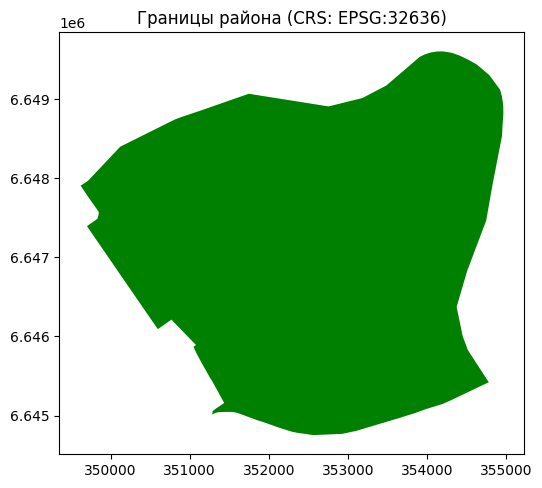

In [19]:
# Визуализация
ax = admin_polygon.plot(marker='o', color='green', figsize=(6,6))
plt.title("Границы района (CRS: {})".format(utm_crs))
plt.show()

##### Шаг 2 - Определение экстента (bounding box)


Определим границы области для построения сетки


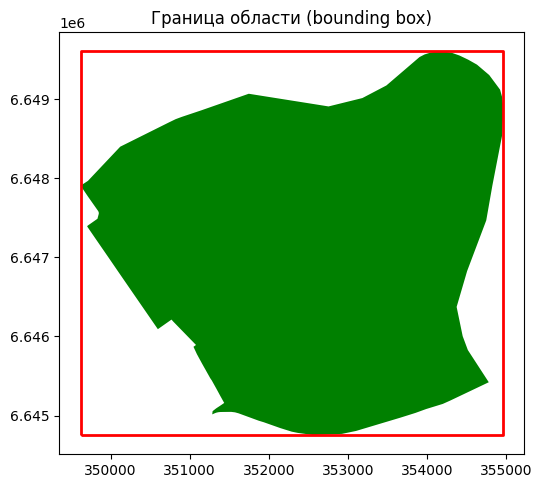

In [20]:
# Определяем минимальные и максимальные значения координат по долготе и по широте
minx, miny, maxx, maxy = admin_polygon.total_bounds

# Строим полигон-рамку (для визуалиации того, что мы получили - не обязательный шаг непосредственно для пострения сетки)
bbox = Polygon([
    (minx, miny), (maxx, miny),
    (maxx, maxy), (minx, maxy)
])

# Посмотрим на результат
ax = admin_polygon.plot(marker='o', color='green', figsize=(6,6))
gpd.GeoSeries([bbox], crs=utm_crs).plot(
    ax=ax, facecolor='none', edgecolor='red', linewidth=2
)
plt.title("Граница области (bounding box)")
plt.show()

##### Шаг 3 - Определеним размер ячейки


In [21]:
# Параметр: размер ячейки (в метрах)
square_size = 500

##### Шаг 4 - Сгенерируем ячейки внутри заданного ограничивающего полигона


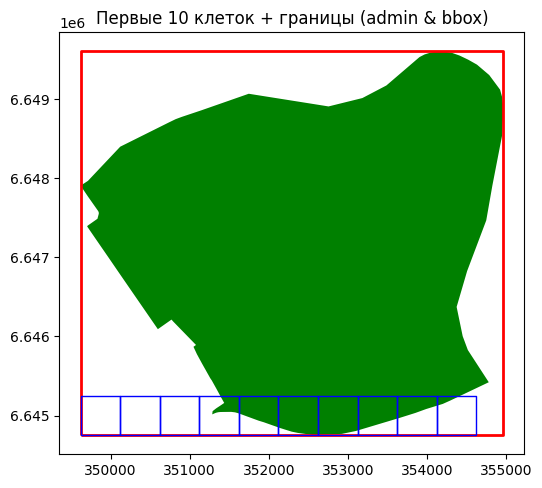

In [22]:
# Список будущих полигонов
grid_cells = []

# Стартовые координаты
x0, y0 = minx, miny
x, y = x0, y0

# Проходим по строкам и столбцам
while y <= maxy:
    while x <= maxx:
        grid_cells.append(
            box(x, y, x + square_size, y + square_size)
        )
        x += square_size
    # после строки: сброс по X и шаг по Y
    x = x0
    y += square_size


# Отфильтруем первые 10 ячеек, чтобы на них посмотреть 
first_few = grid_cells[:10]
ax = gpd.GeoSeries(first_few, crs=utm_crs).plot(
    figsize=(6,6), edgecolor='blue', facecolor='none', zorder=3
)

# отобразим также границу района
admin_polygon.plot(ax=ax, marker='o', color='green', linewidth=1)

# и его экстент
gpd.GeoSeries([bbox], crs=utm_crs).plot(
    ax=ax, facecolor='none', edgecolor='red', linewidth=2
)


plt.title("Первые 10 клеток + границы (admin & bbox)")
plt.show()

##### Шаг 5 - Собирем итоговую сетку в GeoDataFrame


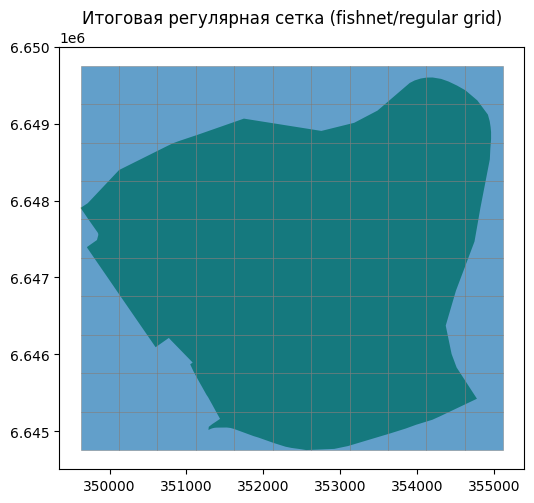

In [23]:
# Собираем всё в GeoDataFrame
fishnet = gpd.GeoDataFrame({'geometry': grid_cells}, crs=utm_crs)

# Показываем итоговую сетку поверх данных
ax = admin_polygon.plot(marker='o', color='green', figsize=(6,6))
fishnet.plot(ax=ax, edgecolor='gray', linewidth=0.5, alpha=0.7)
plt.title("Итоговая регулярная сетка (fishnet/regular grid)")
plt.show()

##### Шаг 6 - Напишем функцию на основе алгоритма


На основе нашего алгоритма напишем функцию, которая на вход будет принимать только исходные данные (для определения экстента) и шаг сетки


In [24]:
from shapely.geometry import Polygon

def create_regular_grid(gdf, square_size):
    # Если набор в географических координатах, перепроецируем в UTM
    utm_crs = gdf.estimate_utm_crs()
    gdf_utm = gdf.to_crs(utm_crs)
    # Получаем границы (bounding box) области
    minX, minY, maxX, maxY = gdf_utm.total_bounds
    grid_cells = []
    x, y = minX, minY
    # Двойной цикл: заполняем прямоугольник границ квадратами заданного размера
    while y <= maxY:
        while x <= maxX:
            grid_cells.append(box(x, y, x + square_size, y + square_size))
            x += square_size # двигаемся по X
        x = minX             # возврат к началу по X
        y += square_size     # двигаемся по Y (следующий ряд)
    # Формируем GeoDataFrame
    fishnet = gpd.GeoDataFrame(geometry=grid_cells, crs=utm_crs)
    return fishnet



In [25]:
# Строим сетку с шагом 200 м
fishnet = create_regular_grid(admin_polygon, square_size=200)
print(f"Создано ячеек: {len(fishnet)}")
fishnet.head(3)

Создано ячеек: 675


,geometry
0,"POLYGON ((349822.326 6644753.924, 349822.326 6..."
1,"POLYGON ((350022.326 6644753.924, 350022.326 6..."
2,"POLYGON ((350222.326 6644753.924, 350222.326 6..."


Посмотрим на сетку на карте


In [26]:
fishnet.explore(tiles='CartoDB positron')

### 2.2 Агрегируем данные - подсчет количества объектов в ячейках (плотность кафе)

Теперь получим данные о расположении **кафе** в исследуемом районе. Используем OSMnx для выгрузки точек с тегом `amenity=cafe` в границах района. Затем с помощью spatial join определим, сколько кафе попадает в каждую ячейку сетки.


##### Шаг1: Выгружаем и обрабатываем нужные данные из OSM


In [27]:
# Выгружаем из OpenStreetMap объекты с тегом "amenity=cafe" в пределах района
tags = {"amenity": "cafe"}
cafes = ox.features_from_place(area, tags)


In [28]:
# Преобразуем полученные объекты в точки (некоторые кафе могут быть полигонами зданий)
cafes_points = gpd.GeoDataFrame(cafes.geometry.centroid, columns=['geometry'], crs=cafes.crs)
print(f"Всего объектов 'cafe': {len(cafes_points)}")

Всего объектов 'cafe': 808


/var/folders/ry/9bb7wrz54vq_kn2ytlj6ynzm0000gn/T/ipykernel_43255/3251615081.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  cafes_points = gpd.GeoDataFrame(cafes.geometry.centroid, columns=['geometry'], crs=cafes.crs)


In [29]:
# Приводим точки кафе к той же проекции, что и сетка (UTM)
cafes_points_utm = cafes_points.to_crs(fishnet.crs)

##### Шаг2: Выполняем пространственное объединение (Spatial Join)


Пересекаем точки с кафе и полигоны регулярной сетки


In [30]:
# sjoin: определяем, в какой квадрат попадает каждое кафе
cafes_in_grid = gpd.sjoin(cafes_points_utm, fishnet, predicate="within", how="left")

cafes_in_grid.head()


geometry  index_right
element id                                                    
node    444776758    POINT (352699.493 6646602.8)          258
        446064734  POINT (351678.463 6645258.762)           64
        446064736   POINT (351650.506 6645295.67)           64
        652383850  POINT (350611.376 6647347.884)          328
        654105840  POINT (352843.747 6646584.659)          259

Считаем количество точек попавших в каждый из полигонов


In [31]:
# Подсчитываем число точек в каждой ячейке (группируем по индексу ячейки)
cafes_count_per_cell = cafes_in_grid.groupby('index_right').size()

cafes_count_per_cell.head()

index_right
12    1
13    1
38    1
45    1
46    1
dtype: int64

Записываем данные в исходный слой с сеткой


In [32]:
# Добавляем столбец с количеством кафе в соответствующую ячейку сетки
fishnet['cafes_count'] = cafes_count_per_cell
fishnet['cafes_count'] = fishnet['cafes_count'].fillna(0).astype(int)  # заполняем 0, где кафе нет
fishnet.head(3)

,geometry,cafes_count
0,"POLYGON ((349822.326 6644753.924, 349822.326 6...",0
1,"POLYGON ((350022.326 6644753.924, 350022.326 6...",0
2,"POLYGON ((350222.326 6644753.924, 350222.326 6...",0


Смотрим на результат


In [33]:
fishnet.explore(column='cafes_count', cmap='YlGnBu', tiles='CartoDB positron')

##### Шаг3: Считаем плотность объектов


Мы добавили к каждой ячейке количество кафе `cafes_count`. Теперь рассчитаем **плотность кафе** – сколько кафе приходится на квадратный километр в границах каждой ячейки


In [34]:
# Вычисляем площадь каждой ячейки в квадратных метрах
cell_area_m2 = fishnet.geometry.area  
# Добавляем столбец плотности кафе (число кафе на 1 км²)
fishnet['cafe_density'] = fishnet['cafes_count'] / (cell_area_m2 / 1_000_000)

fishnet.head()


,geometry,cafes_count,cafe_density
0,"POLYGON ((349822.326 6644753.924, 349822.326 6...",0,0.0
1,"POLYGON ((350022.326 6644753.924, 350022.326 6...",0,0.0
2,"POLYGON ((350222.326 6644753.924, 350222.326 6...",0,0.0
3,"POLYGON ((350422.326 6644753.924, 350422.326 6...",0,0.0
4,"POLYGON ((350622.326 6644753.924, 350622.326 6...",0,0.0


Каждой ячейке присвоим цвет в зависимости от плотности кафе:


In [35]:
fishnet.explore(column='cafe_density', cmap='YlGnBu', scheme='NaturalBreaks', legend=True,
legend_kwds={'caption': 'Кафе на км²'}, tiles='CartoDB positron')


## 3. Итог


На этой неделе мы познакомились с ключевыми инструментами пространственной аналитики: научились создавать буферные зоны, обсудили пространственные предикаты и пространственное объединение, а также научились создавать регулярную сетку и агрегировать на ней точечные данные.
